In [ ]:
#Reads in edge list and plots it

import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline


In [ ]:
# change defaults to be less ugly
mpl.rc('xtick', labelsize=14, color="#222222") 
mpl.rc('ytick', labelsize=14, color="#222222") 
mpl.rc('font', **{'family':'sans-serif','sans-serif':['Arial']})
mpl.rc('font', size=16)
mpl.rc('xtick.major', size=6, width=1)
mpl.rc('xtick.minor', size=3, width=1)
mpl.rc('ytick.major', size=6, width=1)
mpl.rc('ytick.minor', size=3, width=1)
mpl.rc('axes', linewidth=1, edgecolor="#222222", labelcolor="#222222")
mpl.rc('text', usetex=False, color="#222222")

In [ ]:
G = nx.Graph()

In [ ]:
import csv

edgelist = []

with open('edgelist.csv') as f:
    reader = csv.reader(f, delimiter=',', quotechar='|')
    line = 0
    for row in reader:
        if line == 0:
            print("Headers")
            line += 1
        else:
            edgelist.append([row[0],row[1]])
            line += 1

Headers


In [ ]:
print(edgelist)

[['0QHgL1lAIqAw0HtD7YldmP', '3TVXtAsR1Inumwj472S9r4'], ['0QHgL1lAIqAw0HtD7YldmP', '5f7VJjfbwm532GiveGC0ZK'], ['3TVXtAsR1Inumwj472S9r4', '5f7VJjfbwm532GiveGC0ZK'], ['6jeg7JBX9J9097esK752iR', '3TVXtAsR1Inumwj472S9r4'], ['0hCNtLu0JehylgoiP8L4Gh', '3TVXtAsR1Inumwj472S9r4'], ['0hCNtLu0JehylgoiP8L4Gh', '55Aa2cqylxrFIXC767Z865'], ['3TVXtAsR1Inumwj472S9r4', '55Aa2cqylxrFIXC767Z865'], ['55Aa2cqylxrFIXC767Z865', '3TVXtAsR1Inumwj472S9r4'], ['3KNIG74xSTc3dj0TRy7pGX', '3TVXtAsR1Inumwj472S9r4'], ['3TVXtAsR1Inumwj472S9r4', '3hcs9uc56yIGFCSy9leWe7'], ['62DmErcU7dqZbJaDqwsqzR', '3TVXtAsR1Inumwj472S9r4'], ['62DmErcU7dqZbJaDqwsqzR', '2HPaUgqeutzr3jx5a9WyDV'], ['3TVXtAsR1Inumwj472S9r4', '2HPaUgqeutzr3jx5a9WyDV'], ['6UCQYrcJ6wab6gnQ89OJFh', '3TVXtAsR1Inumwj472S9r4'], ['0QHgL1lAIqAw0HtD7YldmP', '3TVXtAsR1Inumwj472S9r4'], ['0QHgL1lAIqAw0HtD7YldmP', '3TVXtAsR1Inumwj472S9r4'], ['2HPaUgqeutzr3jx5a9WyDV', '3TVXtAsR1Inumwj472S9r4'], ['2HPaUgqeutzr3jx5a9WyDV', '4q3ewBCX7sLwd24euuV69X'], ['3TVXtAsR1Inumwj472S9r4', 

In [ ]:
G.add_edges_from(edgelist)

In [ ]:
N = len(G)
L = G.size()
degrees = [G.degree(node) for node in G]
kmin = min(degrees)
kmax = max(degrees)

In [ ]:
print("Number of nodes: ", N)
print("Number of edges: ", L)
print()
print("Average degree: ", 2*L/N)
print("Average degree (alternate calculation)", np.mean(degrees))
print()
print("Minimum degree: ", kmin)
print("Maximum degree: ", kmax)

Number of nodes:  1262
Number of edges:  2328

Average degree:  3.6893819334389857
Average degree (alternate calculation) 3.6893819334389857

Minimum degree:  1
Maximum degree:  208


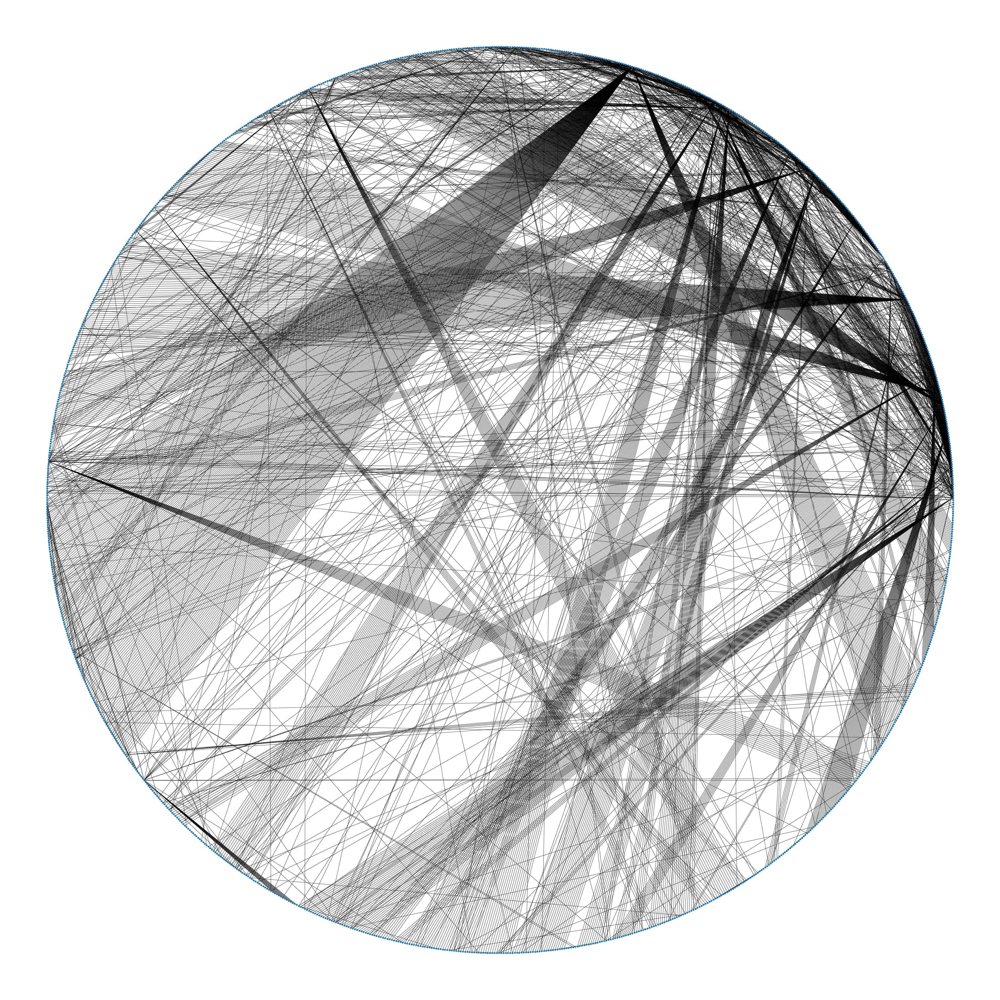

In [ ]:
fig = plt.figure(figsize=(60,60))
nx.draw_circular(G, node_size=50)

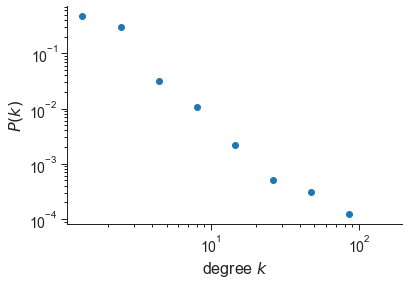

In [ ]:
# Get 10 logarithmically spaced bins between kmin and kmax
bin_edges = np.logspace(np.log10(kmin), np.log10(kmax), num=10)

# histogram the data into these bins
density, _ = np.histogram(degrees, bins=bin_edges, density=True)

fig = plt.figure(figsize=(6,4))

# "x" should be midpoint (IN LOG SPACE) of each bin
log_be = np.log10(bin_edges)
x = 10**((log_be[1:] + log_be[:-1])/2)

plt.loglog(x, density, marker='o', linestyle='none')
plt.xlabel(r"degree $k$", fontsize=16)
plt.ylabel(r"$P(k)$", fontsize=16)

# remove right and top boundaries because they're ugly
ax = plt.gca()
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')

# Show the plot
plt.show()

In [ ]:
# Get 20 logarithmically spaced bins between kmin and kmax
bin_edges = np.linspace(kmin, kmax, num=10)

# histogram the data into these bins
density, _ = np.histogram(degrees, bins=bin_edges, density=True)

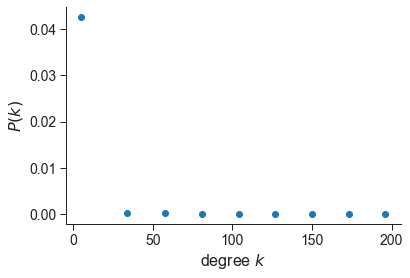

In [ ]:
fig = plt.figure(figsize=(6,4))

# "x" should be midpoint (IN LOG SPACE) of each bin
log_be = np.log10(bin_edges)
x = 10**((log_be[1:] + log_be[:-1])/2)

plt.plot(x, density, marker='o', linestyle='none')
plt.xlabel(r"degree $k$", fontsize=16)
plt.ylabel(r"$P(k)$", fontsize=16)

# remove right and top boundaries because they're ugly
ax = plt.gca()
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')

# Show the plot
plt.show()

In [ ]:
G1 = nx.read_edgelist('./edgelist.csv', comments='#',
                     create_using=nx.Graph(), 
                     delimiter=',', 
                     nodetype=str, 
                     encoding='utf-8')
degrees = [G1.degree[node] for node in G1]
print("Number of nodes: ", N)
print("Number of edges: ", L)
print()
print("Average degree:", np.mean(degrees))
print("Minimum degree: ", min(degrees))
print("Maximum degree: ", max(degrees))

Number of nodes:  1262
Number of edges:  2328

Average degree: 3.685126582278481
Minimum degree:  1
Maximum degree:  208


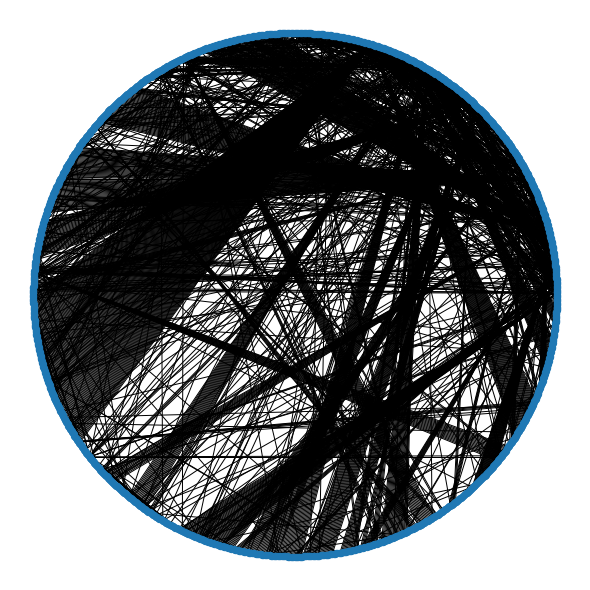

In [ ]:
fig = plt.figure(figsize=(8,8))
nx.draw_circular(G, node_size=40)